In [21]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import chart_studio.plotly as py
import plotly.graph_objects as go
import cufflinks as cf
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)
from textblob import TextBlob
import time
from tqdm.notebook import tqdm

In [3]:
%%time
df = pd.read_csv('../data/df_br_token.csv')
print(df.shape)

(326356, 25)
CPU times: total: 5.53 s
Wall time: 5.56 s


In [4]:
df.head()

,business_id,name,address,city,state,postal_code,latitude,longitude,overall_stars,review_count,...,review_id,user_id,review_stars,useful,funny,cool,date,review_stars.1,text,clean
0,ltBBYdNzkeKdCNPDAsxwAA,Tavern,1904 Broadway,Nashville,TN,37203.0,36.150900,-86.797012,4.0,1222,...,elqRpX9T3YwL07uLNtN3Bg,-sryo4gDYxbZ1T5Bz4l5Bw,2,0,0,0,2015-02-02 04:29:13,2,I at least have to give this restaurant two st...,"['restaurant', 'star', 'decent', 'food', 'dinn..."
1,Zx7n8mdt8OzLRXVzolXNhQ,Milk and Honey Nashville,214 11th Ave S,Nashville,TN,37203.0,36.154702,-86.784541,4.0,1725,...,E9AB7V4z8xrt2uPF7T55FQ,iYY5Ii1LGpZCpXFkHlMefw,5,0,0,0,2018-04-27 23:03:21,5,Amazing biscuits and (fill in the blank). Grea...,"['amazing', 'biscuit', 'fill', 'blank', 'great..."
2,eaJCpC6IhYphj7bwCDHTwQ,Three Brothers Coffee,2813 W End Ave,Nashville,TN,37203.0,36.144808,-86.812266,4.5,249,...,qGQvUHmC02PAZW3H1WTIfw,RRTQpg8hutdimzAYuP_Hbw,5,0,0,0,2015-08-30 13:41:47,5,Stopped by after a Sunday morning walk in the ...,"['stop', 'sunday', 'morning', 'walk', 'park', ..."
3,oQ5CPRt0R3AzFvcjNOqB1w,Edley's Bar-B-Que - 12 South,2706 12th Ave S,Nashville,TN,37204.0,36.122973,-86.789782,4.0,1114,...,67cGcRrS0jTvB8p7rpaPew,8YSxVaD203mE_9FR4nCEVA,3,1,0,0,2016-01-17 13:26:19,3,Honestly the food doesn't knock my socks off b...,"['honestly', 'food', 'knock', 'sock', 'people'..."
4,9OtFX3YzG5keaUMOWU1imA,Champions,600 Marriott Drive,Nashville,TN,37214.0,36.146207,-86.693053,4.0,73,...,DOeEDBfsrNph0ktNkYYFnQ,qVYilGRmY6uemAy_tDpfuA,5,4,0,0,2014-05-26 01:56:19,5,Man. This place is nice. The bartender was awe...,"['man', 'place', 'nice', 'bartender', 'awesome..."


- text length
- bins text length and rating
- patterns
- correlations(vs. satisfaction)
- idenfifying more common words/phrases
- word frequencies analysis
- sentiment analysis
- price range
- location
- working hours/open for a longer time
- visualization
- geographical analysis/traffic
- day of time+ 
- food type vs rating

In [6]:
%%time
df['text_length'] = df['text'].apply(lambda x: len(x))

CPU times: total: 93.8 ms
Wall time: 102 ms


<Axes: xlabel='text_length', ylabel='review_stars'>

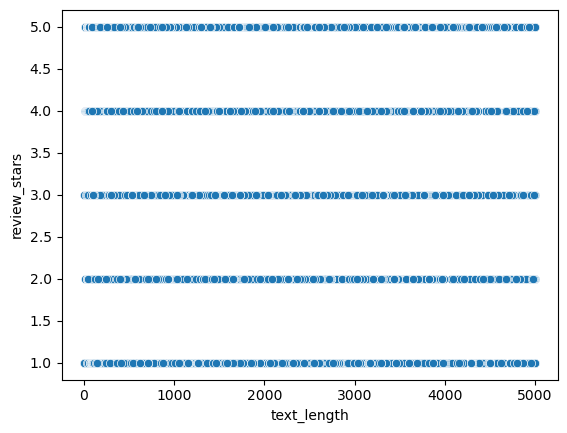

In [8]:
sns.scatterplot(data = df, x= 'text_length', y = 'review_stars')

In [18]:
df['review_stars'].iplot(kind = 'hist', linecolor = 'black', )

In [22]:
%%time
df['polarity'] = df['text'].map(lambda text: TextBlob(text).sentiment.polarity)

CPU times: total: 3min 6s
Wall time: 3min 7s


In [23]:
%%time
df['word_count'] = df['text'].apply(lambda x: len(str(x).split()))

CPU times: total: 1.44 s
Wall time: 1.44 s


In [24]:
df.head(2).T

,0,1
business_id,ltBBYdNzkeKdCNPDAsxwAA,Zx7n8mdt8OzLRXVzolXNhQ
name,Tavern,Milk and Honey Nashville
address,1904 Broadway,214 11th Ave S
city,Nashville,Nashville
state,TN,TN
postal_code,37203.0,37203.0
latitude,36.1509,36.154702
longitude,-86.797012,-86.784541
overall_stars,4.0,4.0
review_count,1222,1725


In [25]:
df.loc[1, 'text']

'Amazing biscuits and (fill in the blank). Great cocktails too. Highly recommended. A bit busy though.'

In [26]:
df[df['polarity'] == df['polarity'].min()]

,business_id,name,address,city,state,postal_code,latitude,longitude,overall_stars,review_count,...,useful,funny,cool,date,review_stars.1,text,clean,text_length,polarity,word_count
692,uzjR6SIeNZUxSvya4SsKKQ,Provence Bread,1 Terminal Dr,Nashville,TN,37214.0,36.128014,-86.669371,1.5,23,...,1,0,0,2016-03-18 13:55:56,1,horrible. in Everyway. coffee\nand food\ntaste...,"['horrible', 'everyway', 'coffee', 'food', 'ta...",109,-1.0,17
1704,ORL4JE6tz3rJxVqkdKfegA,Gaylord Opryland Resort & Convention Center,2800 Opryland Dr,Nashville,TN,37214.0,36.211592,-86.694319,3.0,1639,...,1,0,0,2016-02-25 03:24:40,1,"horrible housekeeping, concierge, restaurant s...","['horrible', 'housekeeping', 'concierge', 'res...",113,-1.0,16
3695,RJPRi1pwocHNZr9ISz_P-A,National Underground,105 Broadway,Nashville,TN,37201.0,36.161795,-86.774466,2.5,126,...,6,0,0,2015-08-09 01:45:42,1,Horrible Staff. Horrible Service. Horrible Sel...,"['horrible', 'staff', 'horrible', 'service', '...",132,-1.0,19
6938,zxpJ4Frr8Zoru-YaNzOxzw,China Spring,8165 Hwy 100,Nashville,TN,37221.0,36.044135,-86.957933,3.5,33,...,0,1,0,2013-05-14 20:54:17,1,I thought I would try it. The egg rolls were ...,"['think', 'try', 'egg', 'roll', 'greasy', 'egg...",173,-1.0,33
7671,YeMouev-sLfAxykmcANNoQ,Bellagio Pizza & Subs,114 29th Ave N B,Nashville,TN,37203.0,36.145647,-86.813791,4.0,160,...,0,0,0,2016-10-08 06:14:33,1,Worst place ever. They take orders and never d...,"['bad', 'place', 'order', 'deliver', 'service'...",168,-1.0,30
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
320744,7P7nix455SqZ8cDhna9rBQ,Shake Shack,5002 Broadway Pl,Nashville,TN,37203.0,36.161124,-86.779191,3.0,18,...,0,0,0,2021-07-15 04:15:55,1,The attitudes of the workers are awful. Also t...,"['attitude', 'worker', 'awful', 'take', 'forev...",155,-1.0,26
324361,fqkEU1N-Q4Yxa1wbXRGpEw,Thai Kitchen,738 Thompson Ln,Nashville,TN,37204.0,36.112733,-86.767904,4.0,126,...,0,0,0,2021-07-14 02:40:54,1,Disgusting. Horrid and screwed up my order twi...,"['disgusting', 'horrid', 'screw', 'order', 'tw...",119,-1.0,22
325671,1b5mnK8bMnnju_cvU65GqQ,Biscuit Love: Gulch,316 11th Ave S,Nashville,TN,37203.0,36.153050,-86.783231,4.0,4207,...,0,0,0,2020-02-11 17:57:40,5,The princess and the East nasty are to die for...,"['princess', 'east', 'nasty', 'die', 'favor', ...",95,-1.0,19
325906,Ybb1739zfXNm3ZZwa8c6Xg,Burger King,1501 Charlotte Ave,Nashville,TN,37203.0,36.159475,-86.795417,1.5,18,...,0,0,0,2022-01-12 18:02:31,1,They turned me away for not having a mask. Lit...,"['turn', 'away', 'have', 'mask', 'literally', ...",343,-1.0,63


In [27]:
df[df['polarity'] == df['polarity'].max()]

,business_id,name,address,city,state,postal_code,latitude,longitude,overall_stars,review_count,...,useful,funny,cool,date,review_stars.1,text,clean,text_length,polarity,word_count
54,iDGohK_mkqnAfLeWC4P4TQ,51st Deli,1314 51st Ave N,Nashville,TN,37209.0,36.161907,-86.848870,4.5,164,...,0,0,0,2017-01-14 21:23:10,5,Found 51st Deli on Uber Eats and we loved it!!...,"['find', '51st', 'deli', 'uber', 'eats', 'love...",87,1.0,19
505,NT5S6JV5wPwKOd3s3Yh1zQ,Burger Up,2901 12th Ave S,Nashville,TN,37212.0,36.121594,-86.790476,4.0,857,...,0,0,0,2013-05-07 03:33:39,4,Always eat here when visiting Nashville. A gre...,"['eat', 'visit', 'nashville', 'great', 'burger...",116,1.0,19
631,kjhIbW8NKRvXmLDwz7lzhw,Margaritaville - Nashville,322 Broadway,Nashville,TN,37201.0,36.161380,-86.777197,3.5,580,...,0,0,1,2017-04-30 18:20:58,5,"Great food, drinks, and service!!! Thank you t...","['great', 'food', 'drink', 'service', 'thank',...",97,1.0,16
706,I2CxrvM0BGH1svfxqGGD2g,M.L.Rose Craft Beer & Burgers - Melrose,"2535 8th Ave S, Ste 107",Nashville,TN,37204.0,36.122623,-86.776137,3.5,472,...,0,0,0,2013-08-04 03:18:26,4,5 Alarm Turkey Burger is one of the best Turke...,"['alarm', 'turkey', 'burger', 'good', 'turkey'...",87,1.0,17
779,VRGYwKE_Z77frm5NwLvJhw,Burger Republic,420 11th Ave S,Nashville,TN,37203.0,36.152436,-86.783581,4.0,721,...,0,0,0,2016-03-17 15:34:15,5,The best place ever. And I'm a burger snob. Th...,"['good', 'place', 'burger', 'snob', 'nutella',...",112,1.0,21
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
324263,4bOqibZuKDbnOa-K0kM4Sg,Flying Saucer Draught Emporium,"111 10th Ave S, Ste 310",Nashville,TN,37203.0,36.156701,-86.783869,4.0,484,...,0,0,0,2021-10-17 16:58:08,5,Came here on a Nashville trip. Worlds best ch...,"['come', 'nashville', 'trip', 'world', 'good',...",115,1.0,21
325475,PC7155v05U9Mg412MDQEKg,Liberty Common,207 First Ave S,Nashville,TN,37201.0,36.159692,-86.773251,4.0,264,...,0,0,0,2020-09-06 21:58:27,5,"Wonderful food, service, and ambiance. Food wa...","['wonderful', 'food', 'service', 'ambiance', '...",85,1.0,13
325654,VAeEXLbEcI9Emt9KGYq9aA,The Pharmacy,731 McFerrin Ave,Nashville,TN,37206.0,36.184936,-86.754188,4.0,3054,...,1,0,1,2021-07-19 01:22:13,5,"If you are ever in the area, Pharmacy Burger i...","['area', 'pharmacy', 'burger', 'place', 'good'...",86,1.0,18
325713,2jwUldEzfMAjPQVCgljLCg,Parlor Doughnuts,"1720 West End Ave, Ste 100",Nashville,TN,37203.0,36.153487,-86.795904,4.5,37,...,0,0,0,2022-01-17 01:38:28,5,I try a donut in every city I visit. The donut...,"['try', 'donut', 'city', 'visit', 'donut', 'wo...",136,1.0,29


In [29]:
df['polarity'].iplot(kind = 'hist', bins = 50, linecolor='black',  colors = 'blue')

In [30]:
df['word_count'].iplot(kind = 'hist', bins = 100, linecolor = 'black', colors = 'blue')

In [36]:
longest_review = df[df['word_count'] == df['word_count'].max()]['text'].iloc[0]
print(longest_review)

like many others, i found this place through Yelpers.  i was visiting from CA, the land of great sushi.  my family and i had checked in late at a nearby hotel and i wanted sushi to go to eat at our hotel because it was so late and hot.  the website said he was closed at 9pm and the address is for the front of the building.  i had a heck of a time finding it in the back of the building since it was on another street and it was dark and the sign was not that obvious.  by the time i drove around in circles, parked illegally, i got to his door at 8:30pm.  there was one party inside the place w/ 4 people.  i told him i wanted to order to go.  he said NO!  i said it is not 9pm and i have been driving around looking for it for over 1/2 hour.  he told me to go to another sushi restaurant because he was tired and wanted to watch tv.  like an idiot, i quickly explained i was visiting and did not know any other place.  he asked why i was at his place and i said someone told me it was good.  i tho